In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
masoudnickparvar_brain_tumor_mri_dataset_path = kagglehub.dataset_download('masoudnickparvar/brain-tumor-mri-dataset')

print('Data source import complete.')


Data source import complete.


# Brain Tumor MRI Classification

## 1. Import Libraries

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.optimizers import Adamax
from tensorflow.keras.metrics import Precision, Recall
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import warnings
import random
warnings.filterwarnings("ignore")

## 2. Load and Prepare Data

In [ ]:
training_path = '/kaggle/input/brain-tumor-mri-dataset/Training'
classes, image_paths = zip(*[(label, os.path.join(training_path, label, image))
                            for label in os.listdir(training_path)
                            if os.path.isdir(os.path.join(training_path, label))
                            for image in os.listdir(os.path.join(training_path, label))])
training_data = pd.DataFrame({'image_path': image_paths, 'label': classes})


testing_path = '/kaggle/input/brain-tumor-mri-dataset/Testing'
classes, image_paths = zip(*[(label, os.path.join(testing_path, label, image))
                            for label in os.listdir(testing_path)
                            if os.path.isdir(os.path.join(testing_path, label))
                            for image in os.listdir(os.path.join(testing_path, label))])
testing_data = pd.DataFrame({'image_path': image_paths, 'label': classes})

## 4. Split and Preprocess Data

In [ ]:
validation_data, test_data = train_test_split(
    testing_data,
    train_size=0.6,
    random_state=20,
    stratify=testing_data['label']
)


batch_size = 32
image_size = (299, 299)

train_datagen = ImageDataGenerator(
    rescale=1/255,
    brightness_range=(0.8, 1.2)
)
test_datagen = ImageDataGenerator(rescale=1/255)

train_generator = train_datagen.flow_from_dataframe(
    training_data,
    x_col='image_path',
    y_col='label',
    batch_size=batch_size,
    target_size=image_size,shuffle=True
)

validation_generator = train_datagen.flow_from_dataframe(
    validation_data,
    x_col='image_path',
    y_col='label',
    batch_size=batch_size,
    target_size=image_size,shuffle=True
)

test_generator = test_datagen.flow_from_dataframe(
    test_data,
    x_col='image_path',
    y_col='label',
    batch_size=16,
    target_size=image_size,
    shuffle=False
)

Found 5712 validated image filenames belonging to 4 classes.
Found 786 validated image filenames belonging to 4 classes.
Found 525 validated image filenames belonging to 4 classes.


Batch image shape: (32, 299, 299, 3)
Batch label shape: (32, 4)


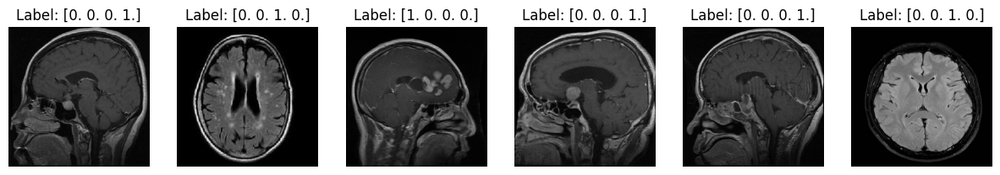

In [ ]:
# Fetch a single batch from the generator
images, labels = next(train_generator)

# Print batch shape details
print(f"Batch image shape: {images.shape}")
print(f"Batch label shape: {labels.shape}")

# Display a few sample images with labels
import matplotlib.pyplot as plt

num_samples = min(6, len(images))
fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))
for i in range(num_samples):
    axes[i].imshow(images[i])
    axes[i].set_title(f'Label: {labels[i]}')
    axes[i].axis('off')

plt.show()

In [ ]:
batch_indices = train_generator.index_array[train_generator.batch_index * train_generator.batch_size:
                                            (train_generator.batch_index + 1) * train_generator.batch_size]

file_paths = [train_generator.filenames[i] for i in batch_indices]

for path in file_paths:
    print(path)

/kaggle/input/brain-tumor-mri-dataset/Training/meningioma/Tr-me_1093.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/meningioma/Tr-me_1299.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/notumor/Tr-no_0364.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/notumor/Tr-no_0172.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_1074.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_1191.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/meningioma/Tr-me_0384.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/glioma/Tr-gl_1214.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_0695.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/notumor/Tr-no_1520.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_1446.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/notumor/Tr-no_0854.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_1079.jpg
/kaggle/input/brain-tumor-mri-dataset/Training/pituitary/Tr-pi_0853.jpg


## 5. Display Sample Images

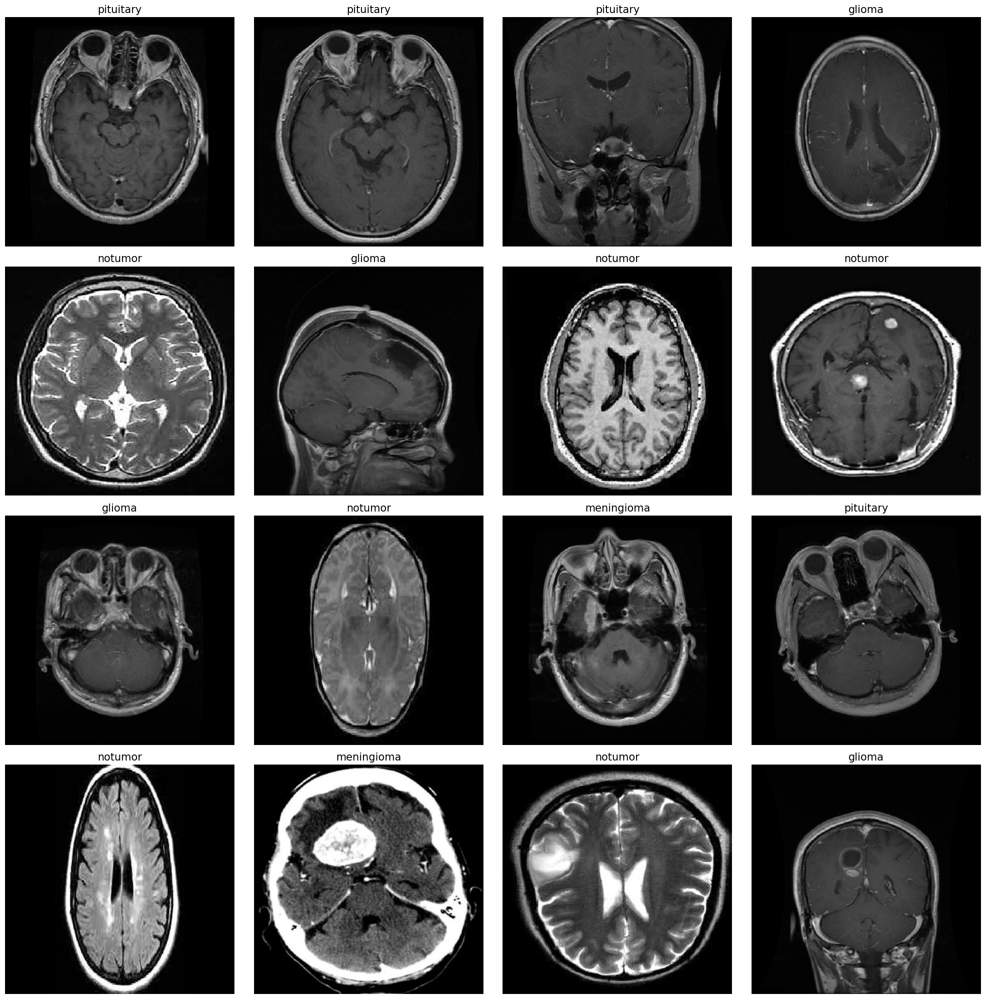

In [ ]:
class_dict = train_generator.class_indices
classes = list(class_dict.keys())
images, labels = next(test_generator)

plt.figure(figsize=(20, 20))
for i, (image, label) in enumerate(zip(images[:16], labels[:16])):
    plt.subplot(4, 4, i + 1)
    plt.imshow(image)
    class_name = classes[np.argmax(label)]
    plt.title(class_name, color='k', fontsize=15)
    plt.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
train_generator.reset()
test_generator.reset()

DCGAN


In [ ]:
# DCGAN Architecture (Generator and Discriminator)
# Example generator architecture (outputs 64x64 RGB image)
class Generator(nn.Module):
    def __init__(self, ngpu, nz=100, ngf=64, nc=3):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),   # (ngf*8) x 4 x 4
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),  # (ngf*4) x 8 x 8
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # (ngf*2) x 16 x 16
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),      # (ngf) x 32 x 32
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),           # nc x 64 x 64
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)



class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),  # -> output shape: (batch, 1, 1, 1)
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1)  # Flatten to shape (batch_size,)


In [ ]:
# Initialize models and optimizers
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# netG = Generator().to(device)
# netD = Discriminator().to(device)
ngpu = 1  # or use torch.cuda.device_count() for dynamic GPU count
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)


# Loss function and optimizers
criterion = nn.BCELoss()
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))

# Training loop
fixed_noise = torch.randn(64, nz, 1, 1, device=device)  # Fixed noise for image generation

for epoch in range(num_epochs):
    for i, data in enumerate(train_loader):
        if i >= 50:  # Limit to 50 batches per epoch
            break

        real_images = data[0].to(device)
        b_size = real_images.size(0)
        real_label = torch.full((b_size,), 1.0, device=device)
        fake_label = torch.full((b_size,), 0.0, device=device)

        # Train Discriminator
        optimizerD.zero_grad()
        output = netD(real_images).view(-1)
        errD_real = criterion(output, real_label)
        errD_real.backward()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_images = netG(noise)
        output = netD(fake_images.detach()).view(-1)
        errD_fake = criterion(output, fake_label)
        errD_fake.backward()

        errD = errD_real + errD_fake
        optimizerD.step()

        # Train Generator
        optimizerG.zero_grad()
        output = netD(fake_images).view(-1)
        errG = criterion(output, real_label)
        errG.backward()
        optimizerG.step()

        if i % 10 == 0:
            print(f"[{epoch}/{num_epochs}] [{i}/50] Loss_D: {errD.item()} Loss_G: {errG.item()}")

    # Save sample images
    if (epoch + 1) % 5 == 0:
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
        vutils.save_image(fake, f"/content/fake_images_epoch_{epoch+1}.png", normalize=True)


# Save the models to Google Drive
torch.save(netG.state_dict(), '/content/drive/MyDrive/generatorGAN.pt')
torch.save(netD.state_dict(), '/content/drive/MyDrive/discriminatorGAN.pt')

print("Training completed and models saved to Google Drive!")

[0/4] [0/50] Loss_D: 1.4190163612365723 Loss_G: 3.012024164199829
[0/4] [10/50] Loss_D: 0.15253540873527527 Loss_G: 6.5179762840271
[0/4] [20/50] Loss_D: 0.1448509246110916 Loss_G: 11.203559875488281
[0/4] [30/50] Loss_D: 0.03754172846674919 Loss_G: 17.140216827392578
[0/4] [40/50] Loss_D: 0.01340275164693594 Loss_G: 15.484759330749512
[1/4] [0/50] Loss_D: 0.021922806277871132 Loss_G: 7.3705220222473145
[1/4] [10/50] Loss_D: 0.6309896111488342 Loss_G: 0.6211977601051331
[1/4] [20/50] Loss_D: 1.9100207090377808 Loss_G: 4.341780662536621
[1/4] [30/50] Loss_D: 0.6288235783576965 Loss_G: 4.3659844398498535
[1/4] [40/50] Loss_D: 0.5065827965736389 Loss_G: 3.69582462310791
[2/4] [0/50] Loss_D: 2.035087823867798 Loss_G: 3.110795021057129
[2/4] [10/50] Loss_D: 0.21511931717395782 Loss_G: 4.166260719299316
[2/4] [20/50] Loss_D: 0.3293662965297699 Loss_G: 4.2238874435424805
[2/4] [30/50] Loss_D: 0.4048658013343811 Loss_G: 2.593050241470337
[2/4] [40/50] Loss_D: 0.21830207109451294 Loss_G: 3.5557

In [ ]:
cnn_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.05,
    height_shift_range=0.05,
    zoom_range=0.1,
    shear_range=0.05,
    brightness_range=[0.7, 1.3],
    rescale=1./255,
    fill_mode='nearest',
    horizontal_flip=False,
    vertical_flip=False
)

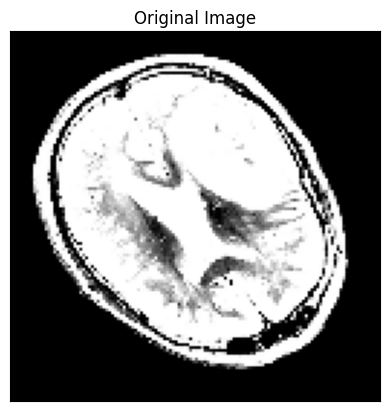

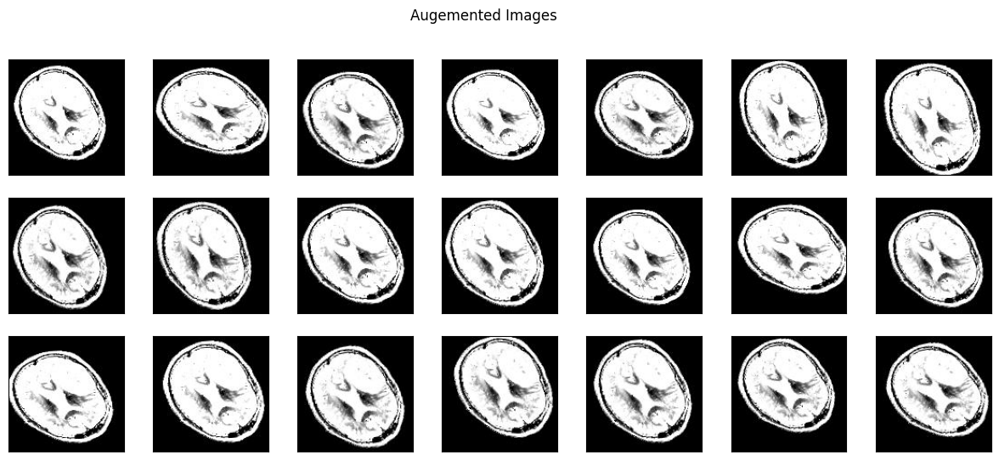

In [ ]:
plt.imshow(X_train_crop[0])
plt.xticks([])
plt.yticks([])
plt.title('Original Image')
plt.show()

plt.figure(figsize=(15,6))
i = 1
for img in os.listdir('p-1/'):
    img = cv2.imread('p-1/' + img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3,7,i)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    i += 1
    if i > 3*7:
        break
plt.suptitle('Augemented Images')
plt.show()

## 6. Build and Train Xception Model

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import Xception
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dropout, Dense
from tensorflow.keras.optimizers import Adamax
from tensorflow.keras.metrics import Precision, Recall
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

image_size = (299, 299)
batch_size = 32

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_dataframe(
dataframe=training_data,
x_col='image_path',
y_col='label',
target_size=image_size,
batch_size=batch_size,
class_mode='categorical',
subset='training',
shuffle=True
)

validation_generator = train_datagen.flow_from_dataframe(
dataframe=training_data,
x_col='image_path',
y_col='label',
target_size=image_size,
batch_size=batch_size,
class_mode='categorical',
subset='validation',
shuffle=False
)

test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_dataframe(
dataframe=testing_data,
x_col='image_path',
y_col='label',
target_size=image_size,
batch_size=batch_size,
class_mode='categorical',
shuffle=False
)

Found 4570 validated image filenames belonging to 4 classes.
Found 1142 validated image filenames belonging to 4 classes.
Found 1311 validated image filenames belonging to 4 classes.


In [ ]:
history = xception_model.fit(
train_generator,
steps_per_epoch=100, # or train_generator.samples // batch_size
epochs=10,
validation_data=validation_generator,
validation_steps=50 # or validation_generator.samples // batch_size
)

xception_model.save("/content/drive/MyDrive/Model/CNNAppModel.h5")

Epoch 1/10
100/100 ━━━━━━━━━━━━━━━━━━━━ 6209s 62s/step - accuracy: 0.7300 - loss: 0.7841 - precision: 0.7936 - recall: 0.6363 - val_accuracy: 0.0263 - val_loss: 4.3834 - val_precision: 0.0158 - val_recall: 0.0149
Epoch 2/10
100/100 ━━━━━━━━━━━━━━━━━━━━ 2911s 29s/step - accuracy: 0.9668 - loss: 0.1122 - precision: 0.9721 - recall: 0.9600 - val_accuracy: 0.8678 - val_loss: 0.4980 - val_precision: 0.8899 - val_recall: 0.8564
Epoch 3/10
100/100 ━━━━━━━━━━━━━━━━━━━━ 6166s 61s/step - accuracy: 0.9837 - loss: 0.0515 - precision: 0.9866 - recall: 0.9822 - val_accuracy: 0.5884 - val_loss: 1.1718 - val_precision: 0.5903 - val_recall: 0.5665
Epoch 4/10
 18/100 ━━━━━━━━━━━━━━━━━━━━ 1:17:38 57s/step - accuracy: 0.9781 - loss: 0.0634 - precision: 0.9789 - recall: 0.9747

In [ ]:
input_shape = (299, 299, 3)
base_model = tf.keras.applications.Xception(
    include_top=False,
    weights="imagenet",
    input_shape=input_shape,
    pooling='max'
)

xception_model = Sequential([
    base_model,
    Flatten(),
    Dropout(rate=0.4),
    Dense(128, activation='relu'),
    Dropout(rate=0.25),
    Dense(4, activation='softmax')
])

xception_model.compile(
    optimizer=Adamax(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy', Precision(), Recall()]
)

In [ ]:
history = xception_model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    shuffle=False
)

Epoch 1/10
  1/179 ━━━━━━━━━━━━━━━━━━━━ 4:40:33 95s/step - accuracy: 0.2812 - loss: 2.5088 - precision_1: 0.2759 - recall_1: 0.2500

In [ ]:
plt.figure(figsize=(12, 5))

# Accuracy plot
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
if 'val_accuracy' in history.history:
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss plot
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
if 'val_loss' in history.history:
    plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

50/50 ━━━━━━━━━━━━━━━━━━━━ 728s 14s/step - accuracy: 0.9574 - loss: 0.1145 - precision_2: 0.9593 - recall_2: 0.9554
50/50 ━━━━━━━━━━━━━━━━━━━━ 338s 7s/step - accuracy: 0.9277 - loss: 0.2405 - precision_2: 0.9296 - recall_2: 0.9256 
50/50 ━━━━━━━━━━━━━━━━━━━━ 222s 4s/step - accuracy: 0.9569 - loss: 0.1863 - precision_2: 0.9569 - recall_2: 0.9569
Train Loss: 0.1335
Train Accuracy: 95.38%
--------------------
Validation Loss: 0.2242
Validation Accuracy: 93.26%
--------------------
Test Loss: 0.2287
Test Accuracy: 95.05%
50/50 ━━━━━━━━━━━━━━━━━━━━ 222s 4s/step


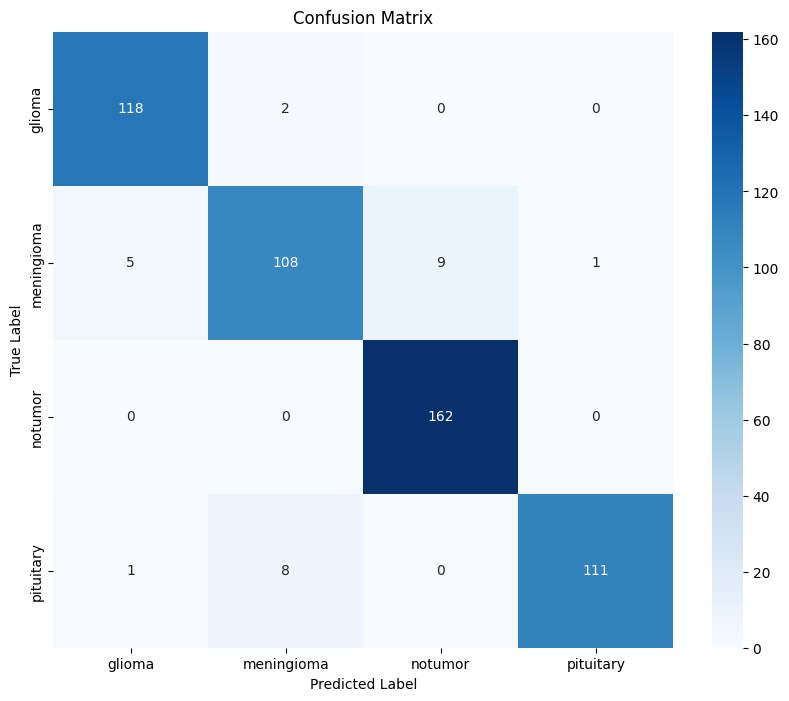

              precision    recall  f1-score   support

      glioma       0.95      0.98      0.97       120
  meningioma       0.92      0.88      0.90       123
     notumor       0.95      1.00      0.97       162
   pituitary       0.99      0.93      0.96       120

    accuracy                           0.95       525
   macro avg       0.95      0.95      0.95       525
weighted avg       0.95      0.95      0.95       525



In [ ]:
# Evaluate only on 50 steps (batches)
train_score = xception_model.evaluate(train_generator, steps=50, verbose=1)
valid_score = xception_model.evaluate(validation_generator, steps=50, verbose=1)
test_score = xception_model.evaluate(test_generator, steps=50, verbose=1)

print(f"Train Loss: {train_score[0]:.4f}")
print(f"Train Accuracy: {train_score[1]*100:.2f}%")
print('-' * 20)
print(f"Validation Loss: {valid_score[0]:.4f}")
print(f"Validation Accuracy: {valid_score[1]*100:.2f}%")
print('-' * 20)
print(f"Test Loss: {test_score[0]:.4f}")
print(f"Test Accuracy: {test_score[1]*100:.2f}%")

# Predict only on 50 steps
predictions = xception_model.predict(test_generator, steps=50)
predicted_labels = np.argmax(predictions, axis=1)

# Make sure to only use the true labels for the same number of steps
true_labels = test_generator.classes[:len(predicted_labels)]

# Confusion Matrix
cm = confusion_matrix(true_labels, predicted_labels)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

# Classification Report
print(classification_report(true_labels, predicted_labels, target_names=classes))


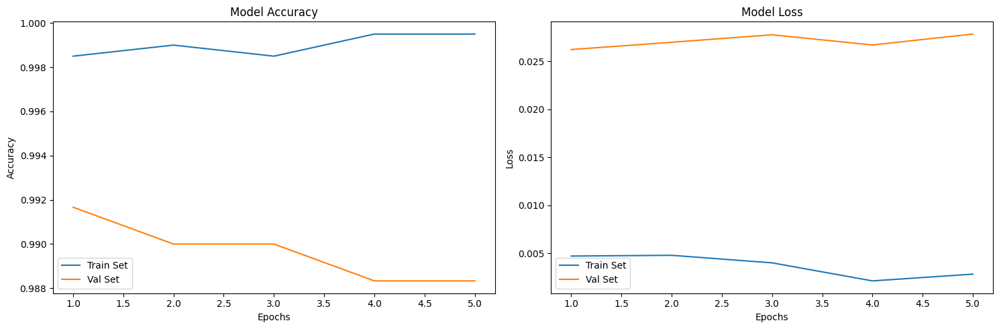

In [ ]:
acc = history_fine.history['accuracy']
val_acc =  history_fine.history['val_accuracy']
loss =  history_fine.history['loss']
val_loss =  history_fine.history['val_loss']
epochs_range = range(1, len(history_fine.epoch) + 1)
plt.figure(figsize=(15,5))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Train Set')
plt.plot(epochs_range, val_acc, label='Val Set')
plt.legend(loc="best")
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Model Accuracy')
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Train Set')
plt.plot(epochs_range, val_loss, label='Val Set')
plt.legend(loc="best")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Model Loss')
plt.tight_layout()
plt.show()

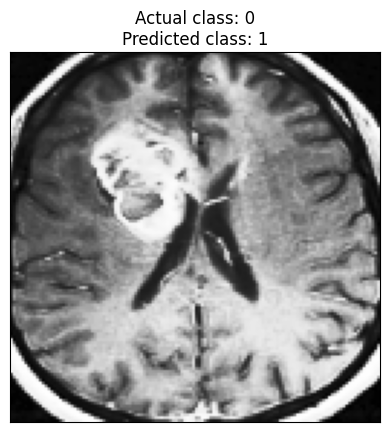

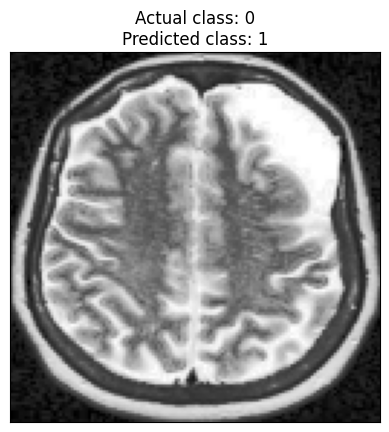

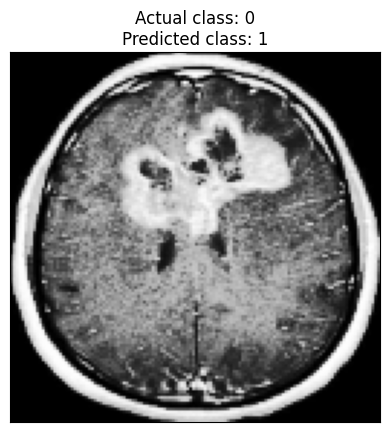

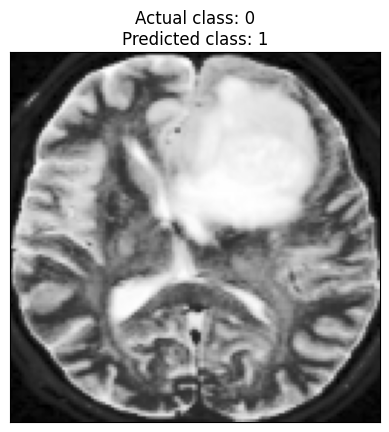

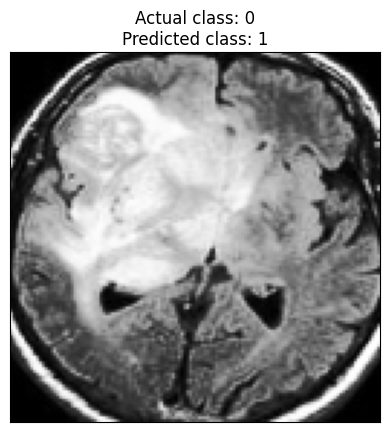

...

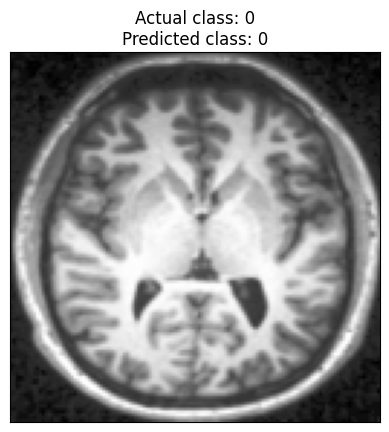

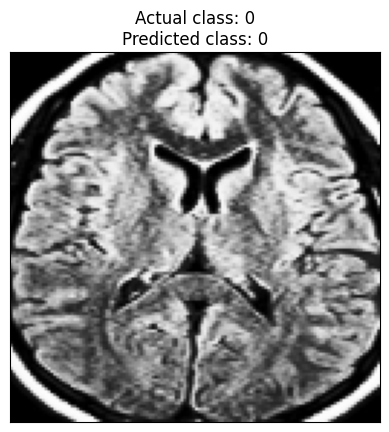

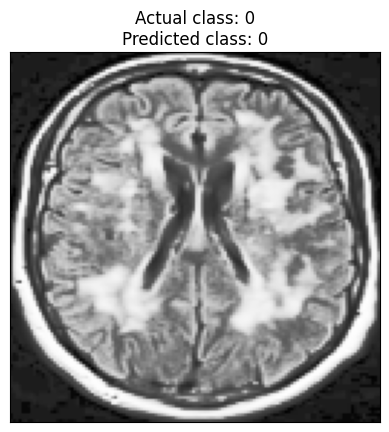

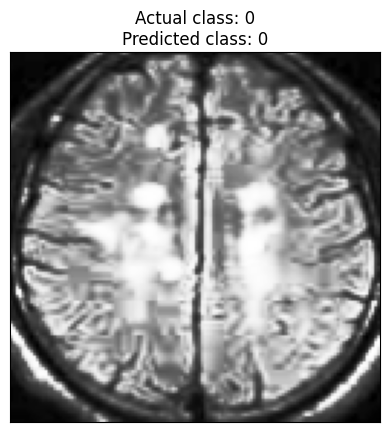

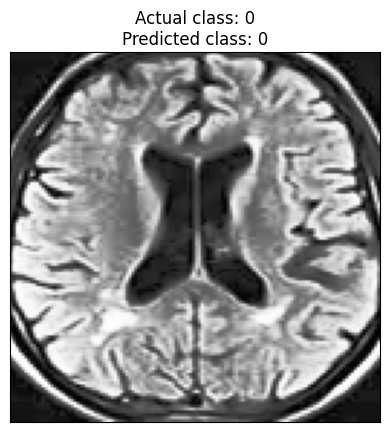

In [ ]:
ind_list = np.argwhere((y_test_bmi == predictions) == False)[:, -1]
print
if ind_list.size == 0:
    print('There are no missclassified images.')
else:
    for i in ind_list:
        plt.figure()
        plt.imshow(X_test_bmi_crop[i])
        plt.xticks([])
        plt.yticks([])
        plt.title(f'Actual class: {y_val[i]}\nPredicted class: {predictions[i]}')
        plt.show()